# 0. Import librairies

In this section, we simply import and prepare the data sets, as we assume alians could do.

## 0.1. Importing the datas

In [1]:
%%capture
# Install dependencies
#!{sys.executable} -m pip install -r "./_SET_UP/requirements.txt"

In [2]:
# Import libraries
import copy
import pandas as pd
import numpy as np
import os
import json
import math
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.graph_objs as go
import plotly.offline as py
import re

from IPython.display import Image
from IPython.display import Markdown
from kaleido.scopes.plotly import PlotlyScope
from wordcloud import WordCloud, ImageColorGenerator
from plotly.offline import iplot
from plotly.subplots import make_subplots

py.offline.init_notebook_mode(connected=True)

In [3]:
# Import external functions
from EXTERNAL_FUNCTIONS import DataImport
from EXTERNAL_FUNCTIONS import DatasetTreatment

In [4]:
# GLOBAL VARIABLE NOT TO SHOW DYNAMIC PLOTLY PLOT IN GITHUB
GITHUB = True

Import the dataset MovieSummaries

In [5]:
PATH_IN = './DATA/MovieSummaries'

# Import data
characterDF_without_ethnicity,movieDF,nameDF,plotDF,tvtropDF = DataImport.OpenMainMovieDatasetDF(PATH_IN)
movieDF = DatasetTreatment.MovieDF_Treatment(movieDF)
# Main dataframe
dataframeList = [characterDF_without_ethnicity,movieDF,nameDF,plotDF,tvtropDF]
dataframeNameList = ['characterDF_without_ethnicity','movieDF','nameDF','plotDF','tvtropDF']


C:\Users\jlefo\Desktop\ADA\github_tea4two\ada-2023-project-tea4two\EXTERNAL_FUNCTIONS\DataImport.py:26: ParserWarning:

Length of header or names does not match length of data. This leads to a loss of data with index_col=False.



In [6]:
# display dataframes of the dataset
display(characterDF_without_ethnicity.head(), 
        movieDF.head(), 
        nameDF.head(), 
        plotDF.head(), 
        tvtropDF.head())

,Wikipedia movie ID,Freebase movie ID,Movie release date,Character Name,Actor DOB,Actor gender,Actor height,Actor ethnicity,Actor Name,Actor age at movie release,Freebase character map
0,975900,/m/03vyhn,2001-08-24,Akooshay,1958-08-26,F,1.620,NaN,Wanda De Jesus,42.0,/m/0bgchxw
1,975900,/m/03vyhn,2001-08-24,Lieutenant Melanie Ballard,1974-08-15,F,1.780,/m/044038p,Natasha Henstridge,27.0,/m/0jys3m
2,975900,/m/03vyhn,2001-08-24,Desolation Williams,1969-06-15,M,1.727,/m/0x67,Ice Cube,32.0,/m/0jys3g
3,975900,/m/03vyhn,2001-08-24,Sgt Jericho Butler,1967-09-12,M,1.750,NaN,Jason Statham,33.0,/m/02vchl6
4,975900,/m/03vyhn,2001-08-24,Bashira Kincaid,1977-09-25,F,1.650,NaN,Clea DuVall,23.0,/m/02vbb3r


,Wikipedia movie ID,Freebase movie ID,Movie name,Movie release date,Movie box office revenue,Movie runtime,Movie languages,Movie countries,Movie genres,Freebase Language,Freebase country,Freebase genre
0,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,14010832.0,98.0,[English Language],[United States of America],"[Thriller, Science Fiction, Horror, Adventure,...",[/m/02h40lc],[/m/09c7w0],"[/m/01jfsb, /m/06n90, /m/03npn, /m/03k9fj, /m/..."
1,3196793,/m/08yl5d,Getting Away with Murder: The JonBenét Ramsey ...,2000-02-16,NaN,95.0,[English Language],[United States of America],"[Mystery, Biographical film, Drama, Crime Drama]",[/m/02h40lc],[/m/09c7w0],"[/m/02n4kr, /m/03bxz7, /m/07s9rl0, /m/0hj3n01]"
2,28463795,/m/0crgdbh,Brun bitter,1988,NaN,83.0,[Norwegian Language],[Norway],"[Crime Fiction, Drama]",[/m/05f_3],[/m/05b4w],"[/m/0lsxr, /m/07s9rl0]"
3,9363483,/m/0285_cd,White Of The Eye,1987,NaN,110.0,[English Language],[United Kingdom],"[Thriller, Erotic thriller, Psychological thri...",[/m/02h40lc],[/m/07ssc],"[/m/01jfsb, /m/0glj9q, /m/09blyk]"
4,261236,/m/01mrr1,A Woman in Flames,1983,NaN,106.0,[German Language],[Germany],[Drama],[/m/04306rv],[/m/0345h],[/m/07s9rl0]


,Character Name,Freebase character map
0,Stuart Little,/m/0k3w9c
1,Stuart Little,/m/0k3wcx
2,Stuart Little,/m/0k3wbn
3,John Doe,/m/0jyg35
4,John Doe,/m/0k2_zn


,Wikipedia movie ID,Plot
0,23890098,"Shlykov, a hard-working taxi driver and Lyosha..."
1,31186339,The nation of Panem consists of a wealthy Capi...
2,20663735,Poovalli Induchoodan is sentenced for six yea...
3,2231378,"The Lemon Drop Kid , a New York City swindler,..."
4,595909,Seventh-day Adventist Church pastor Michael Ch...


,stereotype,char,movie,id,actor
0,absent_minded_professor,Professor Philip Brainard,Flubber,/m/0jy9q0,Robin Williams
1,absent_minded_professor,Professor Keenbean,Richie Rich,/m/02vchl3,Michael McShane
2,absent_minded_professor,Dr. Reinhardt Lane,The Shadow,/m/0k6fkc,Ian McKellen
3,absent_minded_professor,Dr. Harold Medford,Them!,/m/0k6_br,Edmund Gwenn
4,absent_minded_professor,Daniel Jackson,Stargate,/m/0k3rhh,James Spader


Ethnicities are only given by their FreebaseID (e.g. '/m/044038p'). We want to obtain the correspondence between this Freebase and the ethnic groups in English. This is done in the file `Ethnicity_matchning.py`. This produces the .csv file `Ethnicities.csv`, which is laoded in the following cell.

In [7]:
Ethnicity = pd.read_csv('./DATA/Ethnicities.csv')
characterDF = pd.merge(characterDF_without_ethnicity, Ethnicity, on='Actor ethnicity', how='left')
characterDF

,Wikipedia movie ID,Freebase movie ID,Movie release date,Character Name,Actor DOB,Actor gender,Actor height,Actor ethnicity,Actor Name,Actor age at movie release,Freebase character map,ethinicty (en)
0,975900,/m/03vyhn,2001-08-24,Akooshay,1958-08-26,F,1.620,NaN,Wanda De Jesus,42.0,/m/0bgchxw,NaN
1,975900,/m/03vyhn,2001-08-24,Lieutenant Melanie Ballard,1974-08-15,F,1.780,/m/044038p,Natasha Henstridge,27.0,/m/0jys3m,NaN
2,975900,/m/03vyhn,2001-08-24,Desolation Williams,1969-06-15,M,1.727,/m/0x67,Ice Cube,32.0,/m/0jys3g,African Americans
3,975900,/m/03vyhn,2001-08-24,Sgt Jericho Butler,1967-09-12,M,1.750,NaN,Jason Statham,33.0,/m/02vchl6,NaN
4,975900,/m/03vyhn,2001-08-24,Bashira Kincaid,1977-09-25,F,1.650,NaN,Clea DuVall,23.0,/m/02vbb3r,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
450664,913762,/m/03pcrp,1992-05-21,Elensh,1970-05,F,NaN,NaN,Dorothy Elias-Fahn,NaN,/m/0kr406c,NaN
450665,913762,/m/03pcrp,1992-05-21,Hibiki,1965-04-12,M,NaN,NaN,Jonathan Fahn,27.0,/m/0kr405_,NaN
450666,28308153,/m/0cp05t9,1957,NaN,1941-11-18,M,1.730,/m/02w7gg,David Hemmings,15.0,/m/0g8ngmc,English people
450667,28308153,/m/0cp05t9,1957,NaN,NaN,NaN,NaN,NaN,Roberta Paterson,NaN,/m/0g8ngmj,NaN


We remark that few ethnicity FreebaseID don't have a correspondance with an ethnicity (e.g. in row number 1). In this case, we fill it by NaN.

In [8]:
# Display description of the dataframes
for df, name in zip(dataframeList, dataframeNameList):
    print(f"------------ {name} ------------")
    display(df.describe())
    print("-------------------------------------\n")

------------ characterDF_without_ethnicity ------------


,Wikipedia movie ID,Actor height,Actor age at movie release
count,4.506690e+05,154824.000000,292556.000000
mean,1.396975e+07,1.788893,37.788523
std,1.079662e+07,4.379940,20.587870
min,3.300000e+02,0.610000,-7896.000000
25%,3.759292e+06,1.676400,28.000000
50%,1.189065e+07,1.750000,36.000000
75%,2.366501e+07,1.830000,47.000000
max,3.750192e+07,510.000000,103.000000


-------------------------------------

------------ movieDF ------------


,Wikipedia movie ID,Movie box office revenue,Movie runtime
count,8.174100e+04,8.401000e+03,6.129100e+04
mean,1.740784e+07,4.799363e+07,1.118192e+02
std,1.098791e+07,1.121753e+08,4.360070e+03
min,3.300000e+02,1.000000e+04,0.000000e+00
25%,7.323695e+06,2.083193e+06,8.100000e+01
50%,1.777899e+07,1.063969e+07,9.300000e+01
75%,2.715573e+07,4.071696e+07,1.060000e+02
max,3.750192e+07,2.782275e+09,1.079281e+06


-------------------------------------

------------ nameDF ------------


,Character Name,Freebase character map
count,2666,2666
unique,970,2661
top,Daffy Duck,/m/0gcy23_
freq,42,2


-------------------------------------

------------ plotDF ------------


,Wikipedia movie ID
count,4.230300e+04
mean,1.497051e+07
std,1.111994e+07
min,3.300000e+02
25%,4.565802e+06
50%,1.284591e+07
75%,2.485168e+07
max,3.750192e+07


-------------------------------------

------------ tvtropDF ------------


,stereotype,char,movie,id,actor
count,501,501,501,501,501
unique,72,434,383,447,350
top,crazy_jealous_guy,Captain Jack Sparrow,Pirates of the Caribbean: Dead Man's Chest,/m/0k1xxm,Robert De Niro
freq,25,5,7,5,9


-------------------------------------



## 0.2. First looks at the datasets

In [9]:
# Display description of the dataframes
for df, name in zip(dataframeList, dataframeNameList):
    if name == 'plotDF':
        continue
    print(f"------------ {name} ------------")
    display(df.describe())
    print("-------------------------------------\n")

------------ characterDF_without_ethnicity ------------


,Wikipedia movie ID,Actor height,Actor age at movie release
count,4.506690e+05,154824.000000,292556.000000
mean,1.396975e+07,1.788893,37.788523
std,1.079662e+07,4.379940,20.587870
min,3.300000e+02,0.610000,-7896.000000
25%,3.759292e+06,1.676400,28.000000
50%,1.189065e+07,1.750000,36.000000
75%,2.366501e+07,1.830000,47.000000
max,3.750192e+07,510.000000,103.000000


-------------------------------------

------------ movieDF ------------


,Wikipedia movie ID,Movie box office revenue,Movie runtime
count,8.174100e+04,8.401000e+03,6.129100e+04
mean,1.740784e+07,4.799363e+07,1.118192e+02
std,1.098791e+07,1.121753e+08,4.360070e+03
min,3.300000e+02,1.000000e+04,0.000000e+00
25%,7.323695e+06,2.083193e+06,8.100000e+01
50%,1.777899e+07,1.063969e+07,9.300000e+01
75%,2.715573e+07,4.071696e+07,1.060000e+02
max,3.750192e+07,2.782275e+09,1.079281e+06


-------------------------------------

------------ nameDF ------------


,Character Name,Freebase character map
count,2666,2666
unique,970,2661
top,Daffy Duck,/m/0gcy23_
freq,42,2


-------------------------------------

------------ tvtropDF ------------


,stereotype,char,movie,id,actor
count,501,501,501,501,501
unique,72,434,383,447,350
top,crazy_jealous_guy,Captain Jack Sparrow,Pirates of the Caribbean: Dead Man's Chest,/m/0k1xxm,Robert De Niro
freq,25,5,7,5,9


-------------------------------------



In [10]:
# Check for missing values
for df, name in zip(dataframeList, dataframeNameList):
    print(f"------------ {name} ------------")
    missing_values = df.isnull().sum()
    total_values = df.shape[0]  # Total number of rows in the DataFrame

    # Calculate the percentage of missing values
    missing_percentage = (missing_values / total_values) * 100

    # Total number of values for each column
    total_column_values = df.count()

    # Display the results
    missing_info = pd.DataFrame({
        'Total Missing': missing_values,
        'Total Values': total_column_values,
        'Percentage Missing': missing_percentage,
    })

    display(missing_info)
    print("-------------------------------------\n")

------------ characterDF_without_ethnicity ------------


,Total Missing,Total Values,Percentage Missing
Wikipedia movie ID,0,450669,0.000000
Freebase movie ID,0,450669,0.000000
Movie release date,9995,440674,2.217814
Character Name,257875,192794,57.220488
Actor DOB,106145,344524,23.552763
Actor gender,45609,405060,10.120288
Actor height,295845,154824,65.645740
Actor ethnicity,344611,106058,76.466542
Actor Name,1228,449441,0.272484
Actor age at movie release,158113,292556,35.084064


-------------------------------------

------------ movieDF ------------


,Total Missing,Total Values,Percentage Missing
Wikipedia movie ID,0,81741,0.000000
Freebase movie ID,0,81741,0.000000
Movie name,0,81741,0.000000
Movie release date,6902,74839,8.443743
Movie box office revenue,73340,8401,89.722416
Movie runtime,20450,61291,25.018045
Movie languages,0,81741,0.000000
Movie countries,0,81741,0.000000
Movie genres,0,81741,0.000000
Freebase Language,0,81741,0.000000


-------------------------------------

------------ nameDF ------------


,Total Missing,Total Values,Percentage Missing
Character Name,0,2666,0.0
Freebase character map,0,2666,0.0


-------------------------------------

------------ plotDF ------------


,Total Missing,Total Values,Percentage Missing
Wikipedia movie ID,0,42303,0.0
Plot,0,42303,0.0


-------------------------------------

------------ tvtropDF ------------


,Total Missing,Total Values,Percentage Missing
stereotype,0,501,0.0
char,0,501,0.0
movie,0,501,0.0
id,0,501,0.0
actor,0,501,0.0


-------------------------------------



In [11]:
# Print column names
for df, name in zip(dataframeList, dataframeNameList):
    print(f"------------ {name} ------------")
    display(df.columns)
    print("-------------------------------------\n")

------------ characterDF_without_ethnicity ------------


Index(['Wikipedia movie ID', 'Freebase movie ID', 'Movie release date',
       'Character Name', 'Actor DOB', 'Actor gender', 'Actor height',
       'Actor ethnicity', 'Actor Name', 'Actor age at movie release',
       'Freebase character map'],
      dtype='object')

-------------------------------------

------------ movieDF ------------


Index(['Wikipedia movie ID', 'Freebase movie ID', 'Movie name',
       'Movie release date', 'Movie box office revenue', 'Movie runtime',
       'Movie languages', 'Movie countries', 'Movie genres',
       'Freebase Language', 'Freebase country', 'Freebase genre'],
      dtype='object')

-------------------------------------

------------ nameDF ------------


Index(['Character Name', 'Freebase character map'], dtype='object')

-------------------------------------

------------ plotDF ------------


Index(['Wikipedia movie ID', 'Plot'], dtype='object')

-------------------------------------

------------ tvtropDF ------------


Index(['stereotype', 'char', 'movie', 'id', 'actor'], dtype='object')

-------------------------------------



In [12]:
# Cross data frames to fill missing values
# Character Name
characterDF = DataImport.FillMissingValues(characterDF, nameDF, 'Character Name', 'Character Name','Freebase character map')

Percentage of missing values before fill : 57.22%
Percentage of missing values after fill: 57.06%
Percentage improvement: 0.16%


In [13]:
# Cross movie release date
movieDF = DataImport.FillMissingValues(movieDF, characterDF, 'Movie release date', 'Movie release date','Wikipedia movie ID')
characterDF = DataImport.FillMissingValues(characterDF, movieDF, 'Movie release date', 'Movie release date','Wikipedia movie ID')

movieDF['Movie release date'] = pd.to_datetime(movieDF['Movie release date'], format='mixed', errors='coerce',utc=True)
characterDF['Movie release date'] = pd.to_datetime(characterDF['Movie release date'], format='mixed', errors='coerce',utc=True)

# to datetime 'Actor age at movie release'in characterDF
characterDF['Actor age at movie release'] = pd.to_datetime(characterDF['Actor DOB'], format='mixed', errors='coerce',utc=True)

Percentage of missing values before fill : 8.44%
Percentage of missing values after fill: 0.50%
Percentage improvement: 7.95%
Percentage of missing values before fill : 2.22%
Percentage of missing values after fill: 0.10%
Percentage improvement: 2.12%


In [14]:
fig = go.Figure()

# Add box plot for movie release date
fig.add_trace(go.Box(
    x=movieDF["Movie release date"],
    name='Movie Release Date',
    marker=dict(
        color='blue'
    ),
    jitter=0.3,
    pointpos=-1.8,
    boxmean=True
))

# Add box plot for actor age at movie release
fig.add_trace(go.Box(
    x=characterDF['Actor age at movie release'],
    name='Actor Age at Movie Release',
    marker=dict(
        color='red'
    ),
    jitter=0.3,
    pointpos=-1.8,
    boxmean=True
))

# Calculate proportion of NaN values in Actor age at movie release column
nan_proportion = characterDF['Actor age at movie release'].isna().sum() / len(characterDF)

# Calculate proportion of NaN values in Movie release date column
nan_proportion_movie = movieDF['Movie release date'].isna().sum() / len(movieDF)

# Update layout
fig.update_layout(
    title={
        'text': 'Distribution of Movie Release Dates and Actor Ages at Movie Release<br><span style="font-size: 12px;">{:.1%} of Actor Age values are NaN<br>{:.1%} of Movie Release Date values are NaN</span>'.format(nan_proportion, nan_proportion_movie),
        'y': 0.95,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    xaxis=dict(
        title='Year',
        showgrid=True,  # Show vertical grid lines
        gridcolor='rgba(211, 211, 211, 0.6)',  # Set grid line color
        gridwidth=1.2  # Set grid line width
    ),
    yaxis=dict(
        showgrid=False,
        zeroline=False
    ),
    legend=dict(
        x=1.05,
        y=0.5,
        bgcolor='rgba(255, 255, 255, 0.5)',
        bordercolor='rgba(255, 255, 255, 0.5)'
    ),
    plot_bgcolor='rgba(0, 0, 0, 0)',
    paper_bgcolor='rgba(0, 0, 0, 0)',
    boxmode='group'
)

fig.show()

![distrib](IMAGES/distrib_date.png)

This above graph is interessant especially for part 2 where we will work on names depending on the years. The analysis of the name and the age of the actor will be made in the part 2.

# 1. Building a ‘robot portrait’ of human beings thanks to the CMU dataset, and comparing it to reality

## 1.1. Basic considerations (age, height, ethnicity, gender)

### 1.1.1. Gender

Before any discussion, let's see how many male and female characters we have in our dataset. We assume that a female character is always played by an actress, and vice versa.

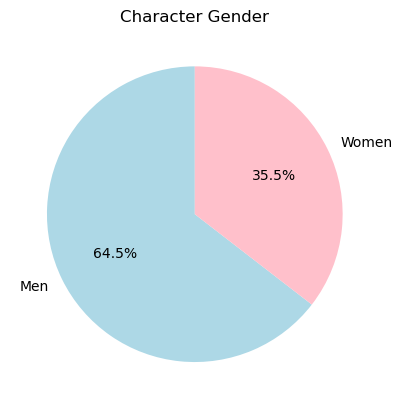

In [15]:
# Count the occurrences of each gender
gender_counts = characterDF.dropna(subset='Character Name')['Actor gender'].value_counts()
# Plot the histogram
plt.figure()
labels = ['Men', 'Women']
sizes = [gender_counts['M'], gender_counts['F']]
colors = ['lightblue', 'pink']
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', shadow=False, startangle=90)
plt.title('Character Gender')
plt.show()

In [16]:
print(f"There is around {round((gender_counts['M']/gender_counts['F'] -1)*100, 1)} % more male-charactors than female-charactors.")

There is around 82.0 % more male-charactors than female-charactors.


The previous graph shows that, in this data set, genders are poorly balanced. In the synopsis of Earth legacy, this could lead to a serious bias (naive aliens will think there are about twice as many men as women on Earth, because men are over-represented).

Let's dig a bit more into this gender-difference. Let's do it over time.

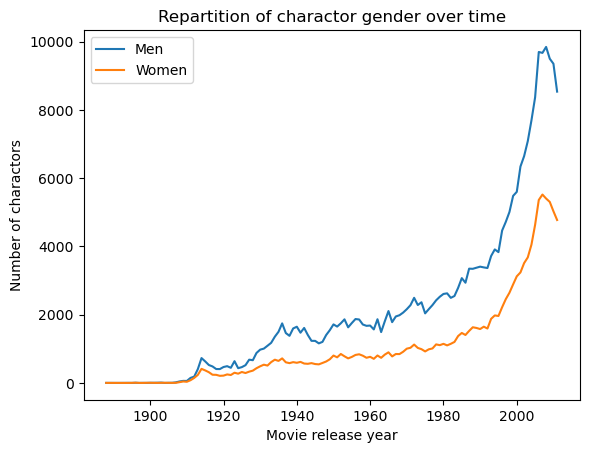

In [17]:
Gender_birth = characterDF[['Actor Name', 'Actor gender', 'Movie release date']].copy()

def year(x):
    x = str(x)
    if len(x) < 4:
        return math.nan
    yr = x[0:4]
    if int(yr) >= 2012:
        return math.nan
    if int(yr) <= 1800:
        return math.nan
    return int(yr)

# Apply the 'year' function to create a new column 'Movie release year'
Gender_birth['Movie release year'] = Gender_birth['Movie release date'].apply(year)

Women = Gender_birth.loc[Gender_birth['Actor gender'] == 'F']
Men = Gender_birth.loc[Gender_birth['Actor gender'] == 'M']
Women = Women.groupby('Movie release year').count()
Men = Men.groupby('Movie release year').count()

plt.plot(Men.index,Men['Actor Name'],label = 'Men')
plt.plot(Women.index,Women['Actor Name'],label = 'Women')
plt.xlabel('Movie release year')
plt.ylabel('Number of charactors')
plt.title('Repartition of charactor gender over time') 
plt.legend()
plt.show()

Alians will still have the same impression, year after year. What to say about the relative difference between female and male character roles?  

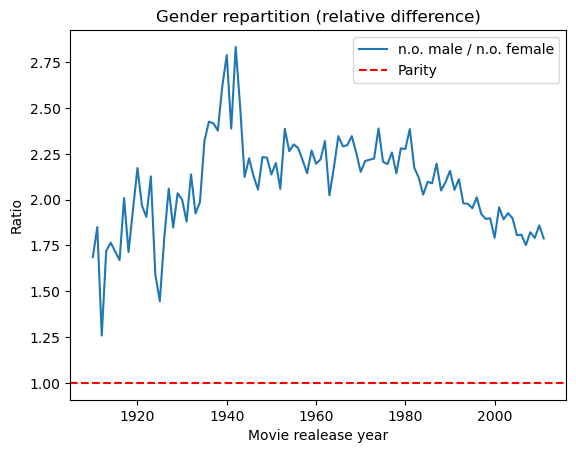

In [18]:
n = len(Men)
ratio = []
for k in range(1910,2012): 
    div = (Men.loc[k,'Actor Name']/Women.loc[k,'Actor Name'])
    ratio.append(div)
plt.plot(np.arange(1910,2012),ratio,label='n.o. male / n.o. female')
plt.axhline(y=1, color='r', linestyle='--', label='Parity')
plt.xlabel('Movie realease year')
plt.ylabel('Ratio') 
plt.title('Gender repartition (relative difference)')
plt.legend()
plt.show()

There is no longer any hope: gender repartition is strongly unbalanced, even in relative scale. Nevertheless, perhaps alians will note the relative difference is slowly deacrising, and should reach parity one day (around 2100 at the speed).

### 1.1.2. Heigth

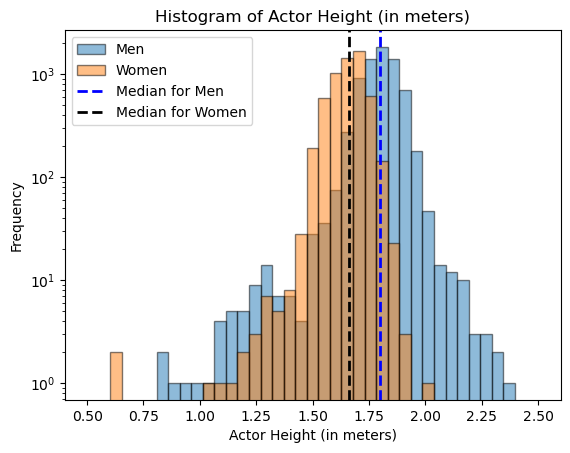

In [20]:
actorDF = characterDF[['Actor Name', 'Actor gender', 'Actor height']]
actorDF = actorDF.drop_duplicates()
actorDF = actorDF.dropna()

# Remove any missing or NaN values from the 'Actor height (in meters)' column
min_height = 0.5
max_height = 2.5
N_boundaries = 40
heights_men = actorDF[(actorDF['Actor height'] > min_height) & \
                      (actorDF['Actor height'] < max_height) & \
                      (actorDF['Actor gender'] == 'M')]\
                ['Actor height'].copy()
heights_women = actorDF[(actorDF['Actor height'] > min_height) & \
                        (actorDF['Actor height'] < max_height) & \
                        (actorDF['Actor gender'] == 'F')]\
                ['Actor height'].copy()
bin_boundaries = np.linspace(min_height, max_height, num=N_boundaries)

plt.hist(heights_men, bins=bin_boundaries, edgecolor='black', label='Men', alpha=0.5)
plt.hist(heights_women, bins=bin_boundaries, edgecolor='black', label='Women', alpha=0.5)

# Add vertical lines for mean values
median_height_men = heights_men.median()
median_height_women = heights_women.median()
plt.axvline(x=median_height_men, color='blue', linestyle='dashed', linewidth=2, label='Median for Men')
plt.axvline(x=median_height_women, color='black', linestyle='dashed', linewidth=2, label='Median for Women')

plt.xlabel('Actor Height (in meters)')
plt.ylabel('Frequency')
plt.title('Histogram of Actor Height (in meters)')
plt.yscale('log')
plt.legend()
plt.show()

Histogram strongly depends on the gender *(we will quantify that in the Milestone 3)*.

### 1.1.3. Ethnicity

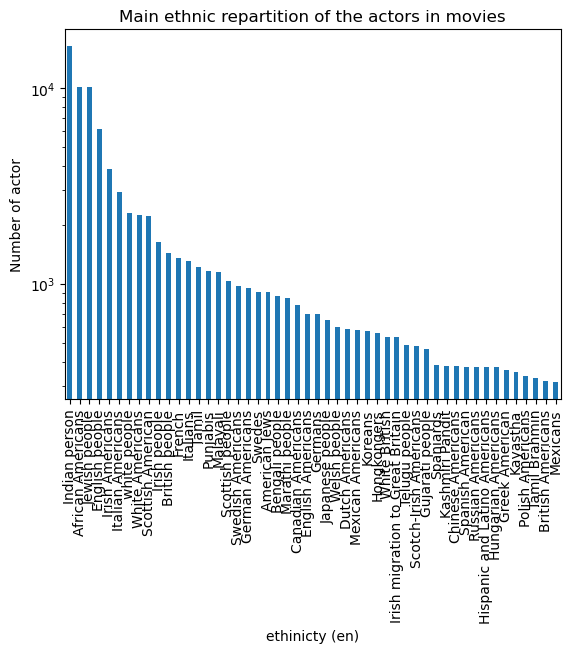

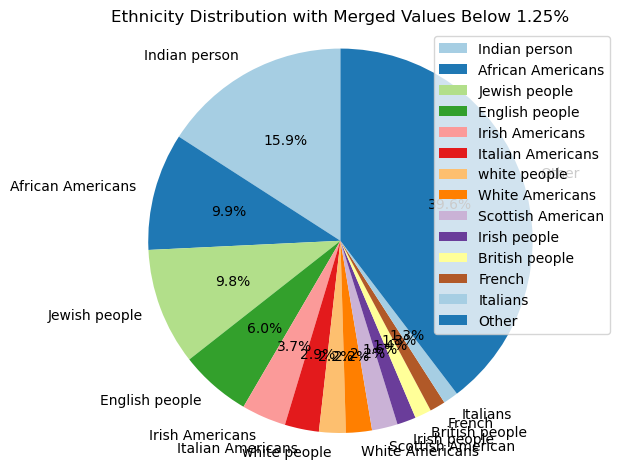

In [21]:
### bar chart
nb_ethnicity = characterDF['ethinicty (en)'].value_counts()
nb_ethnicity_main = nb_ethnicity[0:50]
nb_ethnicity_main.plot(kind = 'bar')
plt.ylabel('Number of actor') 
plt.title('Main ethnic repartition of the actors in movies')
plt.yscale('log')
plt.show()


### pie chart
limit_percentage = 1.25 # limit above which we merge all the values
total_count = sum(nb_ethnicity)
limit_value = total_count * (limit_percentage / 100)
merged_value = sum( value for value in nb_ethnicity.values if value < limit_value )

# Create a dictionary with merged values
merged_ranks_freq = {ethincity: nb_ethnicity[ethincity] for ethincity in nb_ethnicity.keys() if nb_ethnicity[ethincity] >= limit_value}
merged_ranks_freq['Other'] = merged_value

# Extract keys (ranks) and values (frequencies) for plotting
ranks = list(merged_ranks_freq.keys())
values = list(merged_ranks_freq.values())

# pie chart
plt.figure()
plt.pie(values, labels=ranks, autopct='%1.1f%%', startangle=90, colors=plt.cm.Paired.colors)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title(f'Ethnicity Distribution with Merged Values Below {limit_percentage}%')
plt.tight_layout()
plt.legend()
plt.show()

From the aliens' point of view, humans are very different (or like to put people in boxes). Are these differences visible elsewhere?

### 1.1.4. What movie genre do people like ?

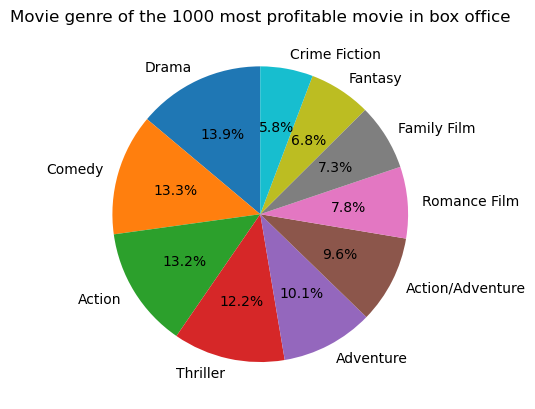

In [22]:
#We look at the 1000 most popular movies based on the box office 
BlockBusters = movieDF.dropna(subset=["Movie box office revenue"]).sort_values(by="Movie box office revenue",ascending=True).tail(1000)
BlockBusters = BlockBusters.explode('Movie genres')

#We plot the 10 most represented genre in the 1000 most profitable movie 
Genre = BlockBusters['Movie genres'].value_counts()
plt.pie(Genre[0:10],labels = Genre[0:10].index,autopct='%1.1f%%', startangle=90)
plt.title('Movie genre of the 1000 most profitable movie in box office')
plt.show()

Well, if there is a difference, it can not be seen by an average approache. We will have to dig into this, for instance studying it by world regions.

## 1.2. Repartition of some occuptions (military, PhD (doctors))

### 1.2.1. Armies

Our aliens are smart. One of them (let's call him Bob) quickly realizes that certain words in the characters' names occur very often, and seem to be militarized according to the role they describe in the scenarios. What is the military organization of Earth?

In [23]:
# MILITARY RANKS
dict_military_ranks = {
    'Marshal': 'Marshal',
    'Admiral': 'Admiral',
    'General': 'General',
    'Brigadier General': 'Brigadier General',
    'Colonel': 'Colonel',
    'Col': 'Colonel',
    'Col.': 'Colonel',
    'Lieutenant Colonel': 'Lieutenant Colonel',
    'Lt. Col': 'Lieutenant Colonel',
    'Major': 'Major',
    'Maj.': 'Major',
    'Captain': 'Captain',
    'Capt.': 'Captain',
    'Commander': 'Commander',
    'Lieutenant Commander': 'Lieutenant Commander',
    'Sheriff': 'Sheriff',
    'Lieutenant': 'Lieutenant',
    'Sergeant': 'Sergeant',
    'Sgt': 'Sergeant',
    'Sgt.': 'Sergeant',
    'Sergeant Major': 'Sergeant Major',
    'Sgt.-Major': 'Sergeant Major',
    'Corporal': 'Corporal',
    'Staff Sergeant': 'Staff Sergeant',
    'Private': 'Private',
    'Major General': 'Major General',
    'Major-General': 'Major General',
    'Major-general': 'Major General'
}

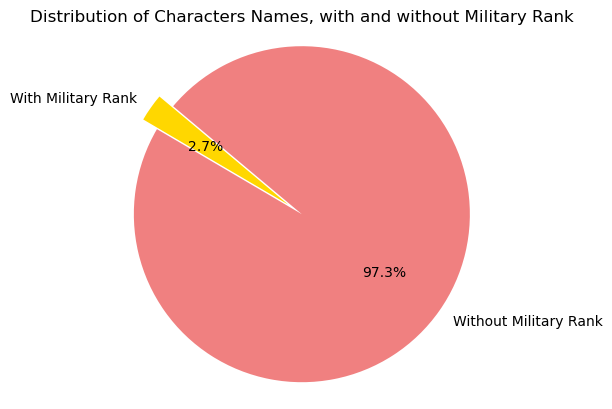

In [24]:
characterDF_copy = copy.deepcopy(characterDF.dropna(subset=['Character Name']))

# Function to check if a military rank is present in the character name
def has_military_rank(name):
    for rank in dict_military_ranks.keys():
        if rank.lower() in name.lower():
            return True
    return False

# Applying the function to the 'Character Name' column
characterDF_copy['Has Military Rank'] = characterDF_copy['Character Name'].apply(has_military_rank)

# Counting the number of characters with and without a military rank
num_characters_with_rank = characterDF_copy['Has Military Rank'].sum()
num_characters_without_rank = len(characterDF_copy) - num_characters_with_rank

# Pie chart
labels = ['With Military Rank', 'Without Military Rank']
sizes = [num_characters_with_rank, num_characters_without_rank]
colors = ['gold', 'lightcoral']
explode = (0.1, 0)  # explode the 'With Military Rank' slice
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%', shadow=False, startangle=140)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title('Distribution of Characters Names, with and without Military Rank')
plt.show()

Less than three percents of the characters are militar ones.

Our alians are really interested in understanding the military hierarchy on Earth. One of them sugests that that there are fewer leaders than subordinates; therfore, the repartition rank should approximate this result... Let's dig into that.

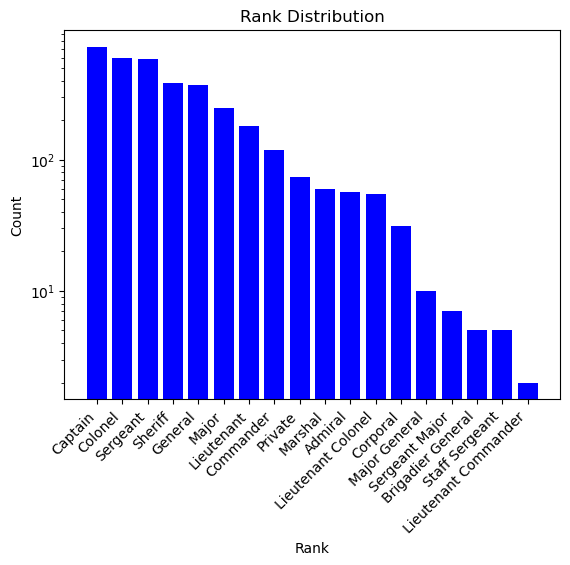

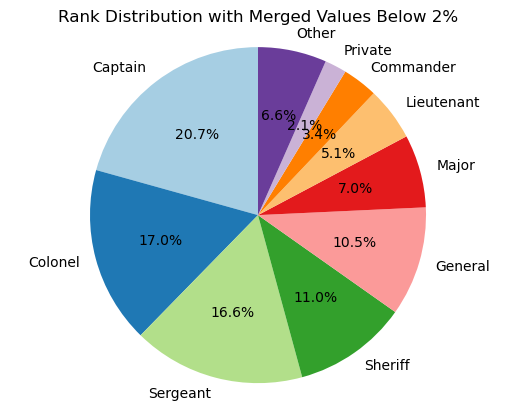

In [25]:
# we sorted the ranks by the decreasing total number of letters, to avoid counting two times the same rank
list_sorted_ranks = sorted(dict_military_ranks.keys(), key=len, reverse=True)

# getting the ranks without repetition
set_mili_ranks = set(dict_military_ranks.values())

# counting the number of each rank
ranks_counter = { rank:0 for rank in set_mili_ranks}
for name in characterDF['Character Name'].dropna(inplace=False):
    for rank in list_sorted_ranks:
        if re.search(fr'\b{rank}\b', name, re.IGNORECASE):
            ranks_counter[ dict_military_ranks[rank] ] +=1
            break #we need to stop to avoid counting two times the same rank (for instance, 'Sgt' and 'Sgt.') 
            
sorted_ranks_freq = dict(sorted(ranks_counter.items(), key=lambda item: item[1], reverse=True))
ranks = list(sorted_ranks_freq.keys())
values = list(sorted_ranks_freq.values())

### histogram
plt.bar(ranks, values, color='blue')
plt.xlabel('Rank')
plt.ylabel('Count')
plt.title('Rank Distribution')
plt.xticks(rotation=45, ha='right')
plt.yscale('log')
plt.show()

### pie chart
limit_percentage = 2 # limit above which we merge all the values
total_count = sum(sorted_ranks_freq.values())
limit_value = total_count * (limit_percentage / 100)
merged_value = sum(value for rank, value in sorted_ranks_freq.items() if value < limit_value)

# Create a new dictionary with merged values
merged_ranks_freq = {rank: value for rank, value in sorted_ranks_freq.items() if value >= limit_value}
merged_ranks_freq['Other'] = merged_value

# Extract keys (ranks) and values (frequencies) for plotting
ranks = list(merged_ranks_freq.keys())
values = list(merged_ranks_freq.values())

# pie chart
plt.pie(values, labels=ranks, autopct='%1.1f%%', startangle=90, colors=plt.cm.Paired.colors)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title(f'Rank Distribution with Merged Values Below {limit_percentage}%')
plt.show()

So the aliens could deduce, for example, that the rank of Private should be higher than that of Captain... There's a cofactor here: the higher you are in the hierarchy, the more important your responsibilities are to the scriptwriters.

### 1.2.2. Doctors

'What about long-studies occupations?' were wondering our alians.

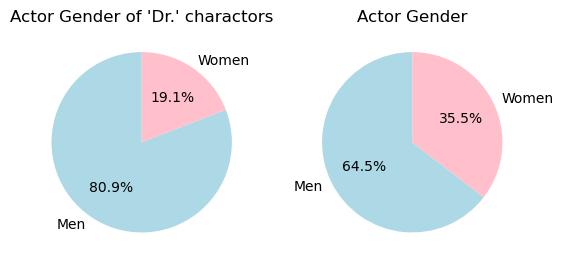

In [26]:
# extracitng doctor lines
df_predoc = characterDF.dropna(subset='Character Name').copy()
df_doctors = df_predoc[ df_predoc['Character Name'].str.lower().str.split().apply(lambda x: x[0] if len(x) > 0 else None)=='dr.' ]

def pie_chart_docs_gender(df, title=''):
    # Count and plot the occurrences of each gender
    gender_counts = df['Actor gender'].value_counts()
    labels = ['Men', 'Women']
    sizes = [gender_counts['M'], gender_counts['F']]
    colors = ['lightblue', 'pink']
    plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', shadow=False, startangle=90)
    plt.title(title)

plt.figure()
plt.subplot(121)
pie_chart_docs_gender(df_doctors, title="Actor Gender of 'Dr.' charactors")
plt.subplot(122)
pie_chart_docs_gender(df_predoc, title='Actor Gender')
plt.show()

We see a clear influence of gender on doctors *(we will quantify it on Milestone 3)*.

# 2. Influence of movies on society, and vice-versa

### 2 a. Adding real babies names dataset and comparing temporal frequencies between reality and fiction (consider only the 100 most famous movies)

##### Study on the top 100 movies

In [27]:
# Define function to format revenue values with K or B suffix
def format_revenue(revenue):
    if revenue >= 1e9:
        return '${:.1f}B'.format(revenue / 1e9)
    elif revenue >= 1e6:
        return '${:.1f}M'.format(revenue / 1e6)
    else:
        return '${:,.0f}'.format(revenue)

# Calculate proportion of NaN values in Movie box office revenue column
nan_proportion = movieDF["Movie box office revenue"].isna().sum() / len(movieDF)

# Create bar chart
fig = go.Figure(go.Bar(
    x=movieDF.dropna(subset=["Movie box office revenue"]).sort_values(by="Movie box office revenue",ascending=True).tail(100)["Movie box office revenue"], 
    y=movieDF.dropna(subset=["Movie box office revenue"]).sort_values(by="Movie box office revenue",ascending=True).tail(100)["Movie name"], 
    orientation='h',
    text=[format_revenue(revenue) for revenue in movieDF.dropna(subset=["Movie box office revenue"]).sort_values(by="Movie box office revenue",ascending=True).tail(100)["Movie box office revenue"]],
    textposition='outside',
    marker=dict(
        color=[i for i in range(100)],
        colorscale='sunsetdark'
    )
))

# Update layout
fig.update_layout(
    height=2000,
    xaxis_title="Box Office Revenue",
    yaxis_title="Movie Name",
    title={
        'text': 'Top 100 Movies by Box Office Revenue<br><span style="font-size: 12px;">{:.1%} of Movie Box Office Revenue values are NaN</span>'.format(nan_proportion),
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    xaxis=dict(
        showgrid=True,  # Show vertical grid lines
        gridcolor='rgba(211, 211, 211, 0.6)',  # Set grid line color
    ),
    plot_bgcolor='rgba(0,0,0,0)',
    paper_bgcolor='rgba(0,0,0,0)',
    font=dict(
        size=12
    ),
    margin=dict(
        l=200
    )
)

# fig.show()

![top100](IMAGES/Top100Movies.png)

Although many films do not have box-office data, it will suffice to focus on the top 100 films in part two. The top 100 films are generally the best-known, and we'll focus on them to observe the trends we consider most relevant to our analysis.

Wordcloud of the top100 movie names

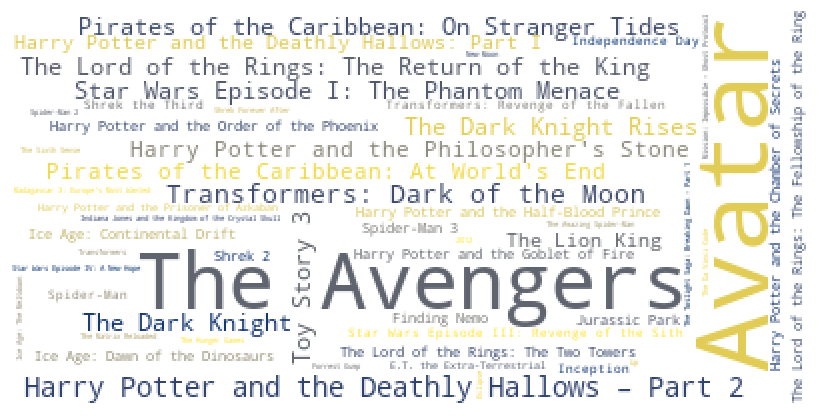

In [47]:
# Drop rows with missing values in the "Movie box office revenue" column
movieDF_cleaned = movieDF.dropna(subset=["Movie box office revenue"])

# Create a dictionary with movie names as keys and their box office revenue as values
movie_name_revenue_dict = dict(zip(movieDF_cleaned["Movie name"], movieDF_cleaned["Movie box office revenue"]))

# Generate the word cloud from the movie names and their box office revenue
wordcloud = WordCloud(
    max_font_size=50,
    background_color="white",
    colormap="cividis",
).generate_from_frequencies(movie_name_revenue_dict)

# Display the word cloud
plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad=0)
plt.show()

##### Study on the characters present in the top 100 movies

Import the babyname dataset in the US

In [48]:
# we will extract only the characters from the top 100 movies in the dataset based movieDF["Movie box office revenue"]
top100_characters = characterDF[characterDF["Wikipedia movie ID"].isin(movieDF.sort_values(by="Movie box office revenue",ascending=False)["Wikipedia movie ID"].head(100))]

# PATH_IN = '.\\DATA\\AddedDatasets\\Name'
PATH_IN = r".\DATA\AddedDatasets\Name"

baby_nameDF = DataImport.OpenBabyNameDf(PATH_IN)

We will study this dataset with a focus of the genre repartition of the firstnames over the years as well as the birth rate each year.

In [49]:
# Create DataFrame for M first names
M_df = baby_nameDF[baby_nameDF['Sexe'] == 'M']

# Create DataFrame for F first names
F_df = baby_nameDF[baby_nameDF['Sexe'] == 'F']

# Create DataFrame for first names that are given to both M and F
MF_df = M_df[['Year', 'Firstname']].merge(F_df[['Year', 'Firstname']], on=['Year', 'Firstname'])

# Remove first names that are in MF_df from M_df and F_df
M_df = M_df[~M_df['Firstname'].isin(MF_df['Firstname'])]
F_df = F_df[~F_df['Firstname'].isin(MF_df['Firstname'])]

# Calculate proportion of unique first names that are given to Males and Females
MF_proportion = len(MF_df['Firstname'].unique()) / len(baby_nameDF['Firstname'].unique())
M_proportion = len(M_df['Firstname'].unique()) / len(baby_nameDF['Firstname'].unique())
F_proportion = len(F_df['Firstname'].unique()) / len(baby_nameDF['Firstname'].unique())

# Create pie chart
fig = px.pie(
    values=[MF_proportion, M_proportion, F_proportion],
    names=['Males and Females', 'Males', 'Females'],
    title='Proportion of Unique First Names by Gender'
)

# Update layout
fig.update_layout(
    plot_bgcolor='rgba(0,0,0,0)',
    paper_bgcolor='rgba(0,0,0,0)',
    font=dict(
        size=12
    )
)

# fig.show()

![proportion](IMAGES/proportionMF.png)

In [31]:
# Create the 'Mixed Sexe' column with initial values
baby_nameDF['Mixed Sexe'] = 'MF'

# Update 'Mixed Sexe' column based on presence in M_df, F_df, and MF_df
baby_nameDF.loc[baby_nameDF['Firstname'].isin(M_df['Firstname'].unique()), 'Mixed Sexe'] = 'M'
baby_nameDF.loc[baby_nameDF['Firstname'].isin(F_df['Firstname'].unique()), 'Mixed Sexe'] = 'F'
baby_nameDF.loc[baby_nameDF['Firstname'].isin(MF_df['Firstname'].unique()), 'Mixed Sexe'] = 'MF'

# Calculate total number of babies by mixed sex and year
mixed_sex_year_df = baby_nameDF.groupby(['Year', 'Mixed Sexe']).sum().reset_index()

# Create area chart
fig = px.area(mixed_sex_year_df, x='Year', y='Number', color='Mixed Sexe', line_group='Mixed Sexe')

# Update layout with log scale on y-axis
fig.update_layout(
    title='Baby Firstname Distribution by Mixed Sex over the Years',
    xaxis_title='Year',
    yaxis_title='Number of Babies (log scale)',
    plot_bgcolor='rgba(0,0,0,0)',
    paper_bgcolor='rgba(0,0,0,0)',
    font=dict(
        size=12
    ),
    yaxis=dict(type='log')  # Set y-axis to log scale
)

# fig.show()

![distrib_sexe](IMAGES/distrib_sexe.png)

##### Extract valid firstnames from character firstname

In [32]:
%%capture
# Create a set of valid first names from baby_nameDF["Firstname"]
valid_firstnames = set(baby_nameDF["Firstname"])
name_occurrences = baby_nameDF[baby_nameDF["Firstname"].isin(valid_firstnames)].groupby("Firstname")["Number"].sum().reset_index()
name_occurrences_dict = dict(zip(name_occurrences["Firstname"], name_occurrences["Number"]))

# Apply the function to the "Character Name" column
top100_characters["Character firstname"] = top100_characters["Character Name"].apply(lambda x: DatasetTreatment.extract_top_firstname(x,valid_firstnames,name_occurrences_dict))
top100_characters.dropna(subset=["Character firstname"], inplace=True)

print("Number of unique name in top100 : ",len(top100_characters["Character firstname"].unique()))
name_occurrences["First year appearance"] = baby_nameDF[baby_nameDF["Firstname"].isin(valid_firstnames)].groupby("Firstname")["Year"].min().reset_index()["Year"]
top100_characters["Year"] = pd.to_datetime(top100_characters["Movie release date"]).dt.year

##### Study on the babies firstname recensed in the US after their presence in a movie

A first simple study could be to see if new firstname ermarged after the apparition of a movie. This doesn't conclude wether the movie created this firstname or not, but the event could be correlated.

In [33]:
# Merge the DataFrames on the "Firstname" column
merged_data = top100_characters.merge(name_occurrences, left_on="Character firstname", right_on="Firstname", how="left")

# Convert the "First year appearance" and "Year" columns to integers
merged_data["First year appearance"] = merged_data["First year appearance"].astype(int)
merged_data["Year"] = merged_data["Year"].astype(int)

# Filter the rows where "First year appearance" is greater than "Year"
filtered_data = merged_data[merged_data["First year appearance"] > merged_data["Year"]]

# Calculate the number of names and their films
num_names_with_films = len(filtered_data)

# Print the result
print("Number of names with their films where the name wasn't present before the film in name_occurrences:", num_names_with_films)

Number of names with their films where the name wasn't present before the film in name_occurrences: 84


In [34]:
# Calculate the number of names and their films
num_names_with_films = len(filtered_data)

# Log-transform the frequencies
filtered_data["LogFrequency"] = np.log1p(filtered_data["Number"])

# Generate the word cloud with a specific colormap (e.g., 'viridis')
wordcloud = WordCloud(
    max_font_size=50,
    max_words=100,
).generate_from_frequencies(dict(zip(filtered_data["Character firstname"], filtered_data["LogFrequency"])))

# Convert the word cloud data to a DataFrame
wordcloud_df = pd.DataFrame({"label": wordcloud.words_.keys(), "log_frequency": wordcloud.words_.values()})

# Create a treemap using Plotly Express with a different color scale
fig = px.treemap(
    wordcloud_df, 
    path=['label'], 
    values='log_frequency',
    color='log_frequency',
    color_continuous_scale='blues',  # Change the color scale to 'blues'
    title='Word Cloud as Treemap (Log-Transformed Frequency)'
)

# Update layout with log scale for size
fig.update_layout(
    height=500,
    margin=dict(l=20, r=20, b=20, t=80),
    title=dict(
        font=dict(size=20),  # Increase title font size
    ),
    plot_bgcolor='rgba(0,0,0,0)',
)

# fig.show()

C:\Users\jlefo\AppData\Local\Temp\ipykernel_26200\469797325.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



![newname](IMAGES/newname.png)

As we can see on the worldcloud map, some names are higly likely to be created by a movie like "Kenobi" in Star Wars or "Ollivander" in Harry Potter.

In [35]:
# display the movie name linked with these name in a pandaframe by crossing Wikipedia movie ID in movieDF
probable_newFirstnameDF = filtered_data.merge(movieDF, left_on="Wikipedia movie ID", right_on="Wikipedia movie ID", how="left")[["Movie name","Character firstname"]].drop_duplicates()

We can make a simple test if it implies that the name comes from a highest-grossing film

In [36]:
probable_newFirstnameDF_inTop400 = movieDF[movieDF["Movie name"].isin(probable_newFirstnameDF["Movie name"])].sort_values(by="Movie box office revenue",ascending=False).head(400)

print("Number of names with their films where the name wasn't present before the film in name_occurrences:", len(probable_newFirstnameDF_inTop400["Movie name"].unique()))

probable_newFirstnameDF_inTop400["Movie name"].unique()

Number of names with their films where the name wasn't present before the film in name_occurrences: 42


array(['Avatar', 'Titanic',
       'Harry Potter and the Deathly Hallows – Part 2',
       'Transformers: Dark of the Moon',
       'The Lord of the Rings: The Return of the King',
       'Star Wars Episode I: The Phantom Menace',
       "Harry Potter and the Philosopher's Stone",
       'Harry Potter and the Deathly Hallows: Part I', 'The Lion King',
       'Harry Potter and the Order of the Phoenix',
       'Harry Potter and the Half-Blood Prince',
       'The Lord of the Rings: The Two Towers', 'Finding Nemo',
       'Harry Potter and the Goblet of Fire',
       'Harry Potter and the Chamber of Secrets',
       'The Lord of the Rings: The Fellowship of the Ring',
       'Star Wars Episode III: Revenge of the Sith',
       'Transformers: Revenge of the Fallen', 'Inception', 'Spider-Man',
       'Harry Potter and the Prisoner of Azkaban',
       'E.T. the Extra-Terrestrial',
       'Indiana Jones and the Kingdom of the Crystal Skull',
       'Spider-Man 2', 'Star Wars Episode IV: A Ne

We are not too suprise of this result. For them it is highly probable that these movies created a trend for these firstnames. Still, it means half of it, hence the other half could be linked with other events.

##### Study on the top 20 firstnames in movies over the year

An other relevant study could be to see a trend in firstnames. We are not just focusing on the new firstnames or the ones highlighted by movies but we would like to see if the major trends in reality also appear in movies. This will guide us to name our human with it's most likely name depending on the year and the location.

In [37]:
import plotly.graph_objects as go

# Choose a year
year = 2022

# Define the valid date range for your dataset
min_valid_date = "1850-01-01"
max_valid_date = "2023-11-11"
characterDF["Year"] = pd.to_datetime(characterDF["Movie release date"]).dt.year

# Apply the function to the "Character Name" column
characterDF["Character firstname"] = characterDF["Character Name"].apply(lambda x: DatasetTreatment.extract_top_firstname(x,valid_firstnames,name_occurrences_dict))
Firstname_characterDF = characterDF
Firstname_characterDF.dropna(subset=["Character firstname"], inplace=True)

# Create a new DataFrame with the number of occurrences of each firstname groupping by the counting given in baby_nameDF of this firstname for each year
# keep only the firstnames present in the film (characterDF["Character firstname"])
name_occurrences_by_year = baby_nameDF.groupby(["Firstname", "Year", "Sexe"])["Number"].sum().reset_index()
name_occurrences_by_year = name_occurrences_by_year[name_occurrences_by_year["Firstname"].isin(characterDF["Character firstname"].unique())]
name_occurrences_by_year["Year"] = pd.to_datetime(name_occurrences_by_year["Year"], format='%Y')

# Create bar chart
fig = go.Figure(go.Bar(
    x=name_occurrences_by_year[name_occurrences_by_year["Year"].dt.year == year].sort_values(by="Number",ascending=True).tail(20)["Number"],
    y=name_occurrences_by_year[name_occurrences_by_year["Year"].dt.year == year].sort_values(by="Number",ascending=True).tail(20)["Firstname"],
    orientation='h',
    text=name_occurrences_by_year[name_occurrences_by_year["Year"].dt.year == year].sort_values(by="Number",ascending=True).tail(20)["Number"],
    textposition='outside',
    marker=dict(
        color=name_occurrences_by_year[name_occurrences_by_year["Year"].dt.year == year].sort_values(by="Number",ascending=True).tail(20)["Sexe"].map({'M': 'rgb(51, 102, 255)', 'F': 'salmon', 'MF': 'grey'})
    )
))

fig.update_layout(
    xaxis_title="Number of occurrences",
    yaxis_title="First name",
    title="Top 20 First Names in {}".format(year),
    plot_bgcolor='rgba(0,0,0,0)'
)

fig.update_yaxes(
    tickfont=dict(
        size=10
    )
)

# fig.show()

![top20firstname](IMAGES/top20firstname.png)

On this trend, a simple way of doing it is to see the top 20 firstnames in movies over the year. We want to see who are the most recurrent firsnames in top50 each year and if we have at the end 50 name (Assumption on the fact that no evolution was seen in the top50 over the year) or way more.(Assumption on the fact that the top50 is not stable over the year).

In [38]:
# Long to compute: around 4min
NumberUniqueFirstname = pd.DataFrame(columns=["Top", "Unique"])
data_list = []

for i in range(1, 1001):
    tmp = name_occurrences_by_year.groupby("Year").apply(lambda x: x.sort_values(by="Number", ascending=False).head(i))
    unique_count = tmp["Firstname"].nunique()
    data_list.append([i, unique_count])

NumberUniqueFirstname = pd.concat([NumberUniqueFirstname, pd.DataFrame(data_list, columns=["Top", "Unique"])], ignore_index=True)

In [39]:
# Line plot of number of unique firstnames in top i (between 1 and 1000) over the years
fig = px.line(NumberUniqueFirstname, x="Top", y="Unique", title='Number of Unique Firstnames in Top i over the Years')

# Calculate tickvals and ticktext for every 100 values on the x-axis
tickvals = list(range(0, 1001, 100))
ticktext = [str(val) for val in tickvals]

fig.update_layout(
    xaxis_title="Top i",
    yaxis_title="Number of Unique Firstnames",
    plot_bgcolor='rgba(0,0,0,0)',
    xaxis=dict(showgrid=True, gridcolor='lightgrey', zeroline=False, tickvals=tickvals, ticktext=ticktext),
    yaxis=dict(showgrid=True, gridcolor='lightgrey', zeroline=False, type='log', dtick=1),
)

# Add scatter markers for each 100 Top
for top in range(100, 1001, 100):
    fig.add_trace(go.Scatter(
        x=[top],
        y=[NumberUniqueFirstname.loc[NumberUniqueFirstname['Top'] == top, 'Unique'].values[0]],
        mode='markers+text',
        text=[NumberUniqueFirstname.loc[NumberUniqueFirstname['Top'] == top, 'Unique'].values[0]],
        textposition='top center',
        marker=dict(color='blue', size=5),
        showlegend=False,
    ))

fig.show()

![uniquefirstname](IMAGES/uniquefirstname.png)

This above graph helps us to understand that over the years, the first tops in firstnames evolved a lot and hence it will be interesting for us to analyse deeper these trends.

### Trying to see if the tendency is that movies are in advance or copy what existed previously.

To lighten the study, we will only focus on the top 400 firstnames in the US. The goal of this study is to have a better understanding of the firstnames in movies compared to what we have in reality. At the end, we are more focusing on if they both follow the same trends with a certain delay or not. This probable correlation will help us to name our human.

In [40]:
TOP = 400

# keep the top 400 firstname in baby_nameDF
firstname_occurrences_by_year = Firstname_characterDF.groupby(["Year", "Character firstname", "Actor gender"]).size().reset_index(name="Number of Occurrences")
# add a column of firstname_occurrences_by_year where it is the Total number of occurences of this firstname in the dataset
firstname_occurrences_by_year["Total number of occurences"] = firstname_occurrences_by_year.groupby(["Character firstname", "Actor gender"])["Number of Occurrences"].transform("sum")

top400_firstnamesDF = baby_nameDF.merge(firstname_occurrences_by_year, left_on="Firstname", right_on="Character firstname", how="left")
top400_firstnamesDF = top400_firstnamesDF[top400_firstnamesDF["Year_x"].astype(float)==top400_firstnamesDF["Year_y"].astype(float)]
top400_firstnamesDF["Year"] = top400_firstnamesDF["Year_x"]
top400_firstnamesDF = top400_firstnamesDF.drop(columns=["Year_x","Year_y"])
top400_firstnamesDF["Firstname"] = top400_firstnamesDF["Firstname"]
top400_firstnamesDF = top400_firstnamesDF.drop(columns=["Character firstname"])
top400_firstnamesDF = top400_firstnamesDF.rename(columns={"Number":"Number of birth","Number of Occurrences":"Number of occurences in movies"})
top400_firstnamesDF =top400_firstnamesDF.drop(columns=["Actor gender"])

# keep the top 400 unique firstname in top400_firstnamesDF in column Number of occurences in movies
keep_top_400 = top400_firstnamesDF.drop_duplicates(subset=["Firstname"])
keep_top_400 = keep_top_400.sort_values(by="Total number of occurences",ascending=False).head(TOP)
top400_firstnamesDF = top400_firstnamesDF[top400_firstnamesDF["Firstname"].isin(keep_top_400["Firstname"])]

sum_by_name_gender = top400_firstnamesDF.groupby(["Firstname", "Sexe"])["Number of birth"].sum().reset_index().rename(columns={"Number of birth": "Number"})
idx_max_gender = sum_by_name_gender.groupby("Firstname")["Number"].idxmax()
max_gender_lines = sum_by_name_gender.loc[idx_max_gender]

top400_firstnamesDF = top400_firstnamesDF.merge(max_gender_lines, on=["Firstname", "Sexe"], how="inner")

To understand what we will be doing at a bigger scale, we will first do it on one individual. Aribitraly, we chose Christopher.
So Christopher, show us what you got!
Is it a trendy name in the US? Was it? Will it be? (no, we're kidding we're not forecasting the name of your eventual future child)
Does movies have an impact on the name of Christopher in the babyname frequency?

In [41]:
firstname = "Christopher"

fig1 = make_subplots(
    rows=1,
    cols=1,
    specs=[[{"secondary_y": True}]]
)

# Sort the dataframes by "Year" for consistency
df1 = top400_firstnamesDF[top400_firstnamesDF["Firstname"] == firstname].sort_values(by="Year")
df2 = top400_firstnamesDF[top400_firstnamesDF["Firstname"] == firstname].sort_values(by="Year")

# Add a trace for the first line (e.g., blue)
trace1 = go.Scatter(x=df1["Year"], y=df1["Number of birth"], mode='lines', name="Number of Birth", line=dict(color='blue'))

# Add a trace for the second line (e.g., red)
trace2 = go.Scatter(x=df2["Year"], y=df2["Number of occurences in movies"], mode='lines', name="Number of Occurrences in Movies", line=dict(color='red'), yaxis="y2")

# Update the subplot and axis properties
fig1.add_trace(trace1, row=1, col=1)
fig1.add_trace(trace2, row=1, col=1, secondary_y=True)

fig1.update_xaxes(title_text='Year', row=1, col=1)
fig1.update_xaxes(showticklabels=True, row=1, col=1)  # Show x-axis tick labels

fig1.update_yaxes(showticklabels=False, row=1, col=1)
fig1.update_yaxes(showticklabels=False, row=1, col=1, secondary_y=True)

fig1.update_layout(
    xaxis_title="Year",
    yaxis_title="Number of Birth",
    title_text=firstname,
    plot_bgcolor='rgba(0,0,0,0)'
    )

# Show the figure
fig1.show()

![christopher_number.png](IMAGES/christopher_number.png)

Well done Christopher! Looks like the babyname occurence of Christopher is in advance of the movie occurence. And fast observation guide to see that there is a delay of 30 years. Could we assume that at 30 years, we have in the movies a correct interpretation of the baynames repartition 30 years before? Difficult to say for the moment.
Oh by the way, is it really the number that is relevant to observe? Or should we look at the frequency of the name in the population?
Actually, it is not really useful or interesting to interpret on numbers, so we plot their frequencies

In [42]:
# Calculate the sum of the number of births and number of firstnames for each year
births_by_year = baby_nameDF.groupby("Year")["Number"].sum().reset_index()
firstnames_by_year = baby_nameDF.groupby("Year")["Firstname"].count().reset_index()

firstname = "Christopher"

# Sort the dataframes by "Year" for consistency
df1 = top400_firstnamesDF[top400_firstnamesDF["Firstname"] == firstname].sort_values(by="Year")
df2 = top400_firstnamesDF[top400_firstnamesDF["Firstname"] == firstname].sort_values(by="Year")

# Calculate the frequency for each year using apply
df1["Frequency"] = df1.apply(lambda row: row["Number of birth"] / births_by_year[births_by_year["Year"] == row["Year"]]["Number"].values[0], axis=1)
df2["Frequency"] = df2.apply(lambda row: row["Number of occurences in movies"] / firstnames_by_year[firstnames_by_year["Year"] == row["Year"]]["Firstname"].values[0], axis=1)

# Rename the columns
df1 = df1.rename(columns={"Frequency": "Frequency of Birth"})
df2 = df2.rename(columns={"Frequency": "Frequency in Movies"})

fig1 = make_subplots(
    rows=1,
    cols=1,
    specs=[[{"secondary_y": True}]]
)

# Add a trace for the first line (e.g., blue)
trace1 = go.Scatter(x=df1["Year"], y=df1["Frequency of Birth"], mode='lines', name="Frequency of Birth", line=dict(color='blue'))

# Add a trace for the second line (e.g., red)
trace2 = go.Scatter(x=df2["Year"], y=df2["Frequency in Movies"], mode='lines', name="Frequency of Occurrences in Movies", line=dict(color='red'), yaxis="y2")

# Update the subplot and axis properties
fig1.add_trace(trace1, row=1, col=1)
fig1.add_trace(trace2, row=1, col=1, secondary_y=True)

fig1.update_xaxes(title_text='Year', row=1, col=1)
fig1.update_xaxes(showticklabels=True, row=1, col=1)  # Show x-axis tick labels

# Hide y-axis labels for both traces
fig1.update_yaxes(showticklabels=False, row=1, col=1)
fig1.update_yaxes(showticklabels=False, row=1, col=1, secondary_y=True)

# Set the subplot title as the firstname
fig1.update_layout(
    xaxis_title="Year",
    yaxis_title="Number of Birth",
    title_text=firstname,
    plot_bgcolor='rgba(0,0,0,0)'
)

# Show the figure
fig1.show()

![christopher_freq.png](IMAGES/christopher_freq.png)

Looks like the results are mitigating on this above graph! We can't conclude the same way or with the same insurance. Later analysis on P3 will be to ass the trust interval on this correlation.
Below, we are processing the same thing as on Christopher but on 400 firstnames!
The diagram could look like a picture on kitchen apron (am I the only one to think that?) but it is not. 2 curves for each firstnames help us to see if a correlation is present and if yes, is it with a delay or not?
Hence, we don't care about the real frequency, we just want to see at once if a trend is shared. 
Last, this graph was chosen because we also want to emphasize on the firstname (like the kitchen apron where each one wants to see if his firstname is present on the graph), so the firstname are ordered alphabetically!
Try to catch your firstname (if you think it could be in top400 firstnames over the years) and see if your parents chose this firstname because a great movie with your firstname was released before your birth?

In [43]:
fig = make_subplots(
    rows=20,
    cols=20,
    subplot_titles=sorted(top400_firstnamesDF["Firstname"].unique()),
    specs=[[{"secondary_y": True}] * 20] * 20
)

legends_added = False  # A flag to ensure legends are added only once

for i, firstname in enumerate(sorted(top400_firstnamesDF["Firstname"].unique())):
    row = i // 20 + 1
    col = i % 20 + 1
    
    # Sort the dataframes by "Year" for consistency
    df1 = top400_firstnamesDF[top400_firstnamesDF["Firstname"] == firstname].sort_values(by="Year")
    df2 = top400_firstnamesDF[top400_firstnamesDF["Firstname"] == firstname].sort_values(by="Year")

    # Calculate the frequency for each year using apply
    df1["Frequency"] = df1.apply(lambda row: row["Number of birth"] / births_by_year[births_by_year["Year"] == row["Year"]]["Number"].values[0], axis=1)
    df2["Frequency"] = df2.apply(lambda row: row["Number of occurences in movies"] / firstnames_by_year[firstnames_by_year["Year"] == row["Year"]]["Firstname"].values[0], axis=1)

    # Rename the columns
    df1 = df1.rename(columns={"Frequency": "Frequency of Birth"})
    df2 = df2.rename(columns={"Frequency": "Frequency in Movies"})

    fig1 = make_subplots(
        rows=1,
        cols=1,
        specs=[[{"secondary_y": True}]]
    )

    if row==1:
        # Add a trace for the first line (e.g., blue)
        trace1 = go.Scatter(x=df1["Year"], y=df1["Frequency of Birth"], mode='lines', name="Frequency of Birth", line=dict(color='blue'),legendgroup='Frequency of birth')
        # Add a trace for the second line (e.g., red)
        trace2 = go.Scatter(x=df2["Year"], y=df2["Frequency in Movies"], mode='lines', name="Frequency of Occurrences in Movies", line=dict(color='orange'),legendgroup='Frequency of occurence in movies', yaxis="y2")

    # Add a trace for the first line (e.g., blue)
    trace1 = go.Scatter(x=df1["Year"], y=df1["Frequency of Birth"], mode='lines', name="Frequency of Birth", line=dict(color='blue'),legendgroup='Frequency of birth',showlegend=False)
    # Add a trace for the second line (e.g., red)
    trace2 = go.Scatter(x=df2["Year"], y=df2["Frequency in Movies"], mode='lines', name="Frequency of Occurrences in Movies", line=dict(color='orange'),legendgroup='Frequency of occurence in movies',showlegend=False, yaxis="y2")

    # Add the traces to the subplot
    fig.add_trace(trace1, row=row, col=col)
    fig.add_trace(trace2, row=row, col=col, secondary_y=True)

    fig.update_xaxes(title_text='', row=row, col=col)  # Remove x-axis label
    fig.update_yaxes(title_text='', row=row, col=col)  # Remove y-axis label for the primary y-axis
    fig.update_yaxes(title_text='', row=row, col=col, secondary_y=True)  # Remove y-axis label for the secondary y-axis
    fig.update_xaxes(showticklabels=False, showgrid=False, row=row, col=col)
    fig.update_yaxes(showticklabels=False, showgrid=False, row=row, col=col)
    fig.update_yaxes(showticklabels=False, showgrid=False, row=row, col=col, secondary_y=True)

    # Set the subplot title as the firstname using update_xaxes
    # fig.update_xaxes(title_text=firstname, row=row, col=col)

# Update the figure properties
fig.update_annotations(font_size=8)
fig.update_layout(
    height=1000,
    width=1400,  # Increase the width to accommodate the legend
    title_text="Firstname occurrence frequency in top400 names over the years",
    plot_bgcolor="white",
    showlegend=True,  # Show the full plot legend
    legend=dict(
        orientation="v",  # Set orientation to vertical for a legend on the right
        x=1.05,  # Adjust the x position as needed
        y=0.5,  # Adjust the y position as needed
        itemsizing='constant',  # Set the size of legend items to be constant
        tracegroupgap=10,  # Add some space between the legend groups
        traceorder="normal",  # Set the order of the legend items
        bgcolor="white",  # Set the background color of the legend
        bordercolor="black",  # Set the border color of the legend
        borderwidth=1,  # Set the border width of the legend
        font=dict(size=8),  # Set the font size of the legend
        title=dict(text="Legend"),  # Set the title of the legend
    ),
    font=dict(size=8),
    xaxis=dict(showticklabels=False, showgrid=False),
    xaxis_title="",
    title_font_size=20,  # set font size of subplot titles
)

# Add a single legend for all subplots
fig.add_trace(go.Scatter(x=[None], y=[None], mode='lines', name="Frequency of Birth", line=dict(color='blue'), legendgroup='Frequency of birth'))
fig.add_trace(go.Scatter(x=[None], y=[None], mode='lines', name="Frequency of Occurrences in Movies", line=dict(color='orange'), legendgroup='Frequency of occurence in movies'))

# Assign the same legend group to all traces
for trace in fig.data:
    trace.legendgroup = trace.name

# Show the figure
fig.show()

Great, but now we are tired of searching for another firstname, we want to see the general trend. We would like to see if some firstnames are in advance of movies in babynames distribution or the contrary. We are less focusing on the firstnames but more on the potential delay of correlation between movies and reality.

In [44]:
%%capture
correlationDF = pd.DataFrame(columns=["Firstname", "Correlation"])

for i, firstname in enumerate(sorted(top400_firstnamesDF["Firstname"].unique())):
    row = i // 20 + 1
    col = i % 20 + 1
    
    # Sort the dataframes by "Year" for consistency
    df1 = top400_firstnamesDF[top400_firstnamesDF["Firstname"] == firstname].sort_values(by="Year")
    df2 = top400_firstnamesDF[top400_firstnamesDF["Firstname"] == firstname].sort_values(by="Year")

    # Calculate the frequency for each year using apply
    df1["Frequency"] = df1.apply(lambda row: row["Number of birth"] / births_by_year[births_by_year["Year"] == row["Year"]]["Number"].values[0], axis=1)
    df2["Frequency"] = df2.apply(lambda row: row["Number of occurences in movies"] / firstnames_by_year[firstnames_by_year["Year"] == row["Year"]]["Firstname"].values[0], axis=1)

    # Rename the columns
    df1 = df1.rename(columns={"Frequency": "Frequency of Birth"})
    df2 = df2.rename(columns={"Frequency": "Frequency in Movies"})
    
    correlationDF = pd.concat([correlationDF, pd.DataFrame([[firstname, df1["Frequency of Birth"].corr(df2["Frequency in Movies"])]], columns=["Firstname", "Correlation"])])

In [45]:
# Create an empty DataFrame to store the results
cross_correlation_results = pd.DataFrame(columns=["FirstName", "Cross-Correlation", "Time Delay"])

# Iterate through the first names
for firstname in top400_firstnamesDF["Firstname"].unique():
    # Sort the dataframes by "Year" for consistency
    df1 = top400_firstnamesDF[top400_firstnamesDF["Firstname"] == firstname].sort_values(by="Year")
    df2 = top400_firstnamesDF[top400_firstnamesDF["Firstname"] == firstname].sort_values(by="Year")

    # Calculate the frequency for each year using apply
    df1["Frequency"] = df1.apply(lambda row: row["Number of birth"] / births_by_year[births_by_year["Year"] == row["Year"]]["Number"].values[0], axis=1)
    df2["Frequency"] = df2.apply(lambda row: row["Number of occurences in movies"] / firstnames_by_year[firstnames_by_year["Year"] == row["Year"]]["Firstname"].values[0], axis=1)

    # Rename the columns
    df1 = df1.rename(columns={"Frequency": "Frequency of Birth"})
    df2 = df2.rename(columns={"Frequency": "Frequency in Movies"})

    # Calculate the cross-correlation and time delay
    cross_correlation = np.correlate(df1["Frequency of Birth"], df2["Frequency in Movies"], mode='full')
    time_delay = np.argmax(cross_correlation) - (len(df2) - 1)  # Calculate the time delay

    # Create a new DataFrame with the result for this firstname
    result_df = pd.DataFrame({"FirstName": [firstname], "Cross-Correlation": [cross_correlation], "Time Delay": [time_delay]})

    # Concatenate the result with the main DataFrame
    cross_correlation_results = pd.concat([cross_correlation_results, result_df], ignore_index=True)

In [46]:
# Prepare Data
df = cross_correlation_results

# Group the data by 'Time Delay' and aggregate the 'FirstName' into a sorted list
dflist = df.groupby('Time Delay')['FirstName'].apply(lambda x: sorted(x)).reset_index()

# Rename the columns for clarity
dflist.columns = ['Time Delay', 'FirstNameList']

# Remove all 0 Time Delay in dflist and store them in another DataFrame
dflist_0 = dflist[dflist["Time Delay"] == 0]
dflist = dflist[dflist["Time Delay"] != 0]
dflist['colors'] = dflist['Time Delay'].astype(float)

# Convert the list of first names into a comma-separated string
dflist['FirstNameList'] = dflist['FirstNameList'].apply(lambda names: ', '.join(names))

# Sort the DataFrame by the 'Time Delay' column in ascending order
dflist = dflist.sort_values(by="Time Delay", ascending=True).reset_index(drop=True)

# Create Diverging Bars Plot with the RdYlGn colormap using the log_colors
fig = px.bar(
    dflist,
    x='Time Delay',
    y=dflist.index,  # Use the index as y-axis values
    color='colors',  # Use the log transformed values for color
    text='FirstNameList',  # Now it contains comma-separated names
    orientation='h',
    width=1500,  # Increase the width to provide more space for the legend
    height=1000,
    color_continuous_scale='RdYlGn',  # Use a diverging colormap
    color_continuous_midpoint= 4.14,
)
fig.update_traces(
    textfont_size=12, 
    textangle=0, 
    textposition="outside",
    cliponaxis=True,
)
fig.update_xaxes(side="top")  # Move the x-axis to the top

# Update the layout for better appearance
fig.update_layout(
    yaxis_title='',
    xaxis_title='Time Delay (Year)',
    title='Comparison of Time Delay for Firstnames between Birth and Movies',
    xaxis=dict(
        title_font=dict(size=10),  # Set the x-axis title font size
        tickfont=dict(size=8),
    ),
    font=dict(size=20),  # Set the main title font size
    title_x=0.5,  # Center-align the title
    yaxis=dict(
        tickvals=dflist.index,
        ticktext=dflist['FirstNameList'],  # Use 'FirstName' column for tick labels
        tickfont=dict(size=8),
        showticklabels=False,
        showgrid=False
    ),
    showlegend=False,
    plot_bgcolor="white",
    margin=dict(t=150, b=40),  # Adjust the top and bottom margins as needed
)

# Set the coloraxis title to reflect the log scale
fig.update_coloraxes(colorbar_title="Time Delay")
fig.update_coloraxes(colorbar_tickfont_size=8)  # Set the color axis font size
fig.update_coloraxes(colorbar_len=0.6, colorbar_thickness=20)  # Adjust the color bar size


#Add annotations
str1="Movies in advance of Birth"
str2="Movies after Birth"
fig.add_annotation(x=-12, y=60, text=str1, font=dict(size=16), showarrow=False)
fig.add_annotation(x=7, y=23, text=str2, font=dict(size=16), showarrow=False)

first_names = dflist_0["FirstNameList"].values[0]
formatted_names = ",\n".join(", ".join(first_names[i:i+10]) for i in range(0, len(first_names), 10))
print("The first names that have 0 time delay are:")
print(formatted_names)

fig.show()

The first names that have 0 time delay are:
Abraham, Al, Albert, Alice, Allen, Andrew, Andy, Anita, Anjali, Anne,
Anthony, Arnold, Audrey, Bar, Ben, Bernard, Bruno, Buddy, Captain, Carlos,
Catherine, Charlie, Charlotte, Chief, Claire, Clara, Colin, Colonel, Count, Daisy,
Daniel, Doctor, Donald, Douglas, Driver, Earl, El, Elaine, Eleanor, Elena,
Elizabeth, Ellen, Emma, Eugene, Eva, Evelyn, Felix, Frankie, Freddy, Girl,
Grace, Gus, Gwen, Harvey, Hector, Henry, Iris, Jacob, Jake, Janet,
Jesse, Jessie, Josh, Julia, Karl, Kate, Kenny, Khan, Kitty, Lady,
Lawrence, Lee, Leo, Leon, Leonard, Lewis, Lieutenant, Little, Lola, Lord,
Lucy, Luke, Mac, Maggie, Major, Marcus, Marvin, Maurice, Mohan, Molly,
Mona, Morris, Nancy, Ned, Nelson, Nina, Nora, Oliver, Oscar, Philip,
President, Priest, Queen, Raju, Raymond, Rosa, Rose, Ruby, Ruth, Samuel,
Shankar, Sharma, Sheila, Sheriff, Shirley, Stella, Sylvia, Ted, Teddy, The,
Thomas, Vanessa, Vera, Veronica, Victor, Victoria, Vikram, Vincent, Warren, Will,


This is a more proper way to improve our thoughts on the potential correlation of the firstnames in movies and in reality. As from the beginning, we want to see the trends, we will have to continue on this way for the final analysis. This new argument that will help us to affine our analysis:
- We are not focusing on feminity or masculinity of the firstname
- We are not focusing on the origin/country of the firstname
- We could look to see if trendy firstnames in reality have a trend delay in movies

# 3. What would be the ideal dataset to give to aliens so they have the best picture of our civilization

In [52]:
from scipy import signal
from scipy.fftpack import fft, fftshift
import matplotlib.pyplot as plt

In [53]:
# Filtering

# We first eliminate all actors whose gender is not either 'M' of 'F'. 
# Then, we create a new dataframe where actors are grouped by the movie they played in. 

print(f'The size of the characterDF dataset is {len(characterDF)}')
characterDF = characterDF.dropna(subset=['Actor gender']).copy(deep = True)
print(f'The size of the characterDF dataset (without the NaN genders) is {len(characterDF)}')

# Now, we filter this dataframe by getting rid of all movies with minus than 5 actors. 
# This prevents us from performing analyses on a too reduced number of actors,
# which would penalize the relevance of considering an arbitrarily large pool of movies. 

nb_actor = characterDF[['Wikipedia movie ID', 'Actor gender']].groupby('Wikipedia movie ID').count()
ls = nb_actor.loc[nb_actor['Actor gender']>5].index.tolist()
ls = np.array(ls)
display(characterDF.head())

characterDF = characterDF[characterDF['Wikipedia movie ID'].isin(ls)].copy(deep=True)
display(characterDF.head())
print(f'The size of the newly created characterDF dataset (with only movies with more than 5 actors) is {len(characterDF)}')

# As of now, we have movies with at least 5 actors in them.
# As the coming analyses will focus on subsets of 100 movies, it comes down to at least 500 actors, which we
# consider sufficient in order to give statistically relevant results.

The size of the characterDF dataset is 144988
The size of the characterDF dataset (without the NaN genders) is 140029


,Wikipedia movie ID,Freebase movie ID,Movie release date,Character Name,Actor DOB,Actor gender,Actor height,Actor ethnicity,Actor Name,Actor age at movie release,Freebase character map,ethinicty (en),Year,Character firstname
1,975900,/m/03vyhn,2001-08-24 00:00:00+00:00,Lieutenant Melanie Ballard,1974-08-15,F,1.780,/m/044038p,Natasha Henstridge,1974-08-15 00:00:00+00:00,/m/0jys3m,NaN,2001.0,Melanie
2,975900,/m/03vyhn,2001-08-24 00:00:00+00:00,Desolation Williams,1969-06-15,M,1.727,/m/0x67,Ice Cube,1969-06-15 00:00:00+00:00,/m/0jys3g,African Americans,2001.0,Williams
3,975900,/m/03vyhn,2001-08-24 00:00:00+00:00,Sgt Jericho Butler,1967-09-12,M,1.750,NaN,Jason Statham,1967-09-12 00:00:00+00:00,/m/02vchl6,NaN,2001.0,Jericho
4,975900,/m/03vyhn,2001-08-24 00:00:00+00:00,Bashira Kincaid,1977-09-25,F,1.650,NaN,Clea DuVall,1977-09-25 00:00:00+00:00,/m/02vbb3r,NaN,2001.0,Kincaid
5,975900,/m/03vyhn,2001-08-24 00:00:00+00:00,Commander Helena Braddock,1949-05-26,F,1.727,/m/0x67,Pam Grier,1949-05-26 00:00:00+00:00,/m/02vdcfp,African Americans,2001.0,Helena


,Wikipedia movie ID,Freebase movie ID,Movie release date,Character Name,Actor DOB,Actor gender,Actor height,Actor ethnicity,Actor Name,Actor age at movie release,Freebase character map,ethinicty (en),Year,Character firstname
1,975900,/m/03vyhn,2001-08-24 00:00:00+00:00,Lieutenant Melanie Ballard,1974-08-15,F,1.780,/m/044038p,Natasha Henstridge,1974-08-15 00:00:00+00:00,/m/0jys3m,NaN,2001.0,Melanie
2,975900,/m/03vyhn,2001-08-24 00:00:00+00:00,Desolation Williams,1969-06-15,M,1.727,/m/0x67,Ice Cube,1969-06-15 00:00:00+00:00,/m/0jys3g,African Americans,2001.0,Williams
3,975900,/m/03vyhn,2001-08-24 00:00:00+00:00,Sgt Jericho Butler,1967-09-12,M,1.750,NaN,Jason Statham,1967-09-12 00:00:00+00:00,/m/02vchl6,NaN,2001.0,Jericho
4,975900,/m/03vyhn,2001-08-24 00:00:00+00:00,Bashira Kincaid,1977-09-25,F,1.650,NaN,Clea DuVall,1977-09-25 00:00:00+00:00,/m/02vbb3r,NaN,2001.0,Kincaid
5,975900,/m/03vyhn,2001-08-24 00:00:00+00:00,Commander Helena Braddock,1949-05-26,F,1.727,/m/0x67,Pam Grier,1949-05-26 00:00:00+00:00,/m/02vdcfp,African Americans,2001.0,Helena


The size of the newly created characterDF dataset (with only movies with more than 5 actors) is 95990


USA references:

In [56]:
# read reference data to create reference dictionary for the USA
usa_ref = {}
df_ages = pd.read_excel('./DATA/real_data/Distribution_ages_usa.xlsx')
df_heights = pd.read_excel('./DATA/real_data/Distribution_heights_usa.xlsx', sheet_name='Final version results only')

usa_ref['par']={'F':100/198.1, 'M':98.1/198.1}   # for 100 women, there are 98.1 men
usa_ref['hei']={'F':df_heights['FEMALES'],
                'M':df_heights['MALES']}  #% of men, % of women in the considered age range

usa_ref['age']={'F':[0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.05,0.02,0.02],
                'M':[0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.05,0.02,0.02]}


## Scoring functions

For the following, our goal is ton construct a metric $S$ to evaluate the representativeness score of a pool of movies $P$. This score should compare statistics from $P$ with references statistics $R$ found on the Internet, based on the following features :
- respect of men and women proportion ($S_{parity}$ subscore)
- age distribution ($S_{age}$ subscore)
- height distribution ($S_{height}$ subscore)
- ethnicity diversity ($S_{div}$ subscore)

Each subscore is rated on a scale $[0,1]$ where $0$ means the studied pool of movie is completely opposed to the reference we consider representative, and $1$ is a perfect representation. They are then aggregated and weighted to create $S$, taking entire values between $0$ and $100$. The higher the representativeness score, the better $P$ statistics approach our reference $R$.

In [57]:
def scoring_function(value, target,p,sigma):
    """ Scoring function.
    
    @arg
        value : value between 0 and 1, given by the pool of movie (e.g. frequency)
        target : corresponding target value between 0 and 1, given by statistic on real world
        p : the higher it is, the longer the plateau near the central value is
        sigma : the higher it is, the stronger the thresholding is
    
    @output
        score : between 0 (if value very far from target) and 1 (if value==target)
                The score is not linearly linked with the diffence |value - target|:
                for instance, the score is about 0.5 if a difference of 15% is observed between value and target.
    """
    
    #100 first centered values of the generalized gaussian (the 50th coefficient is the center and equals 1)
    generalized_gaussian = signal.windows.general_gaussian(101, p=p, sig=sigma)
    discrete_distance_to_the_ref = int(round(value-target, 2)*100)
    generalized_gaussian_index = 50+discrete_distance_to_the_ref
    
    #Handling cases where the index is out of range ('value' too far from 'target')
    if generalized_gaussian_index<0 or generalized_gaussian_index>100:
        generalized_gaussian_index=0
    
    score = generalized_gaussian[generalized_gaussian_index]
    return score


def parity_score(pool, ref=usa_ref['par'], p=1.5, sigma=15):
    
    p_F_ref = ref['F'] # reference value for women proportion
    p_F = pool['Actor gender'].apply(lambda x: x=="F").mean() #proportion of women in the movie pool
    
    return scoring_function(p_F,p_F_ref,p,sigma)
 

def age_score(pool, ref=usa_ref['age'], p=1.5, sigma=5):
    """
    function to evaluate the difference between the age distribution of the actors in the movie
    and the real distribution.

    @arguments
        pool : dataframe containing the pool of movie that will be scored
        ref : tool containing the reference for age distribution
        p : the higher it is, the longer the plateau near the central value is
        sigma : the higher it is, the stronger the thresholding is

    @outputs
        age_sc = unitarized age score evaluation. If equal 1, the distribution is exactly the ref

    """
    # Creation of age ranges
    age_ranges = range(0,80,5)
    Nb_bin = len(age_ranges)
    
    # Separation of the pool depending on the gender
    pool_M = pool[pool["Actor gender"]=='M']
    pool_F = pool[pool["Actor gender"]=='F']
    
    # Recuperation of reference frequencies for each age range depending on the gender
    freq_ref_M = ref['M']
    freq_ref_F = ref['F']
    
    # Computation of movie frequencies for each age range depending on the gender
    cmu_age_M = pool_M['Actor age at movie release'].dropna()
    freq_cmu_M = np.histogram(cmu_age_M, bins = age_ranges, density = True)
    cmu_age_F = pool_F['Actor age at movie release'].dropna()
    freq_cmu_F = np.histogram(cmu_age_F, bins = age_ranges, density = True)
    
    # Computation of each subscore and aggregation
    age_sc_M = 0
    age_sc_F = 0
    weights = [5,5,5,5,1,1,1,1,1,1,5,5,5,5,5,5]
    for i in range(Nb_bin-1):
        age_sc_M += scoring_function(freq_cmu_M[0][i],freq_ref_M[i],p,sigma)*weights[i]
        age_sc_F += scoring_function(freq_cmu_M[0][i],freq_ref_M[i],p,sigma)*weights[i]
    age_sc_M = age_sc_M/sum(weights)
    age_sc_F = age_sc_F/sum(weights)
        
    # Recuperation of men proportion in the pool for gender weighting
    p_M = pool['Actor gender'].apply(lambda x: x=="M").mean()

    return p_M*age_sc_M+(1-p_M)*age_sc_F

def rescued_age_score(pool, ref=usa_ref['age'], p=1.5, sigma=5, min_score=0.3, max_score=0.6):
    normalized_score = (age_score(pool,ref,p,sigma)-min_score)/(max_score-min_score)
    return normalized_score

def height_score(pool, ref=usa_ref['hei'],p=1.5,sigma=5):
    """
    function to evaluate the difference between the age distribution of the actors in the movie
    and the real distribution.
    IDEAS : do the histogram area difference, but also penalize too high representation of some ages ?

    @arguments
        pool : dataframe containing the pool of movie that will be scored
        ref : tool containing the reference for age distribution
        p : the higher it is, the longer the plateau near the central value is
        sigma : the higher it is, the stronger the thresholding is

    @outputs
        hei_sc = unitarized height score evaluation.

    """
    # Creation of age ranges
    hei_ranges = range(142,191,3)
    Nb_bin = len(hei_ranges)
    
    # Separation of the pool depending on the gender
    pool_M = pool.query("Actor gender=='M'")
    pool_F = pool.query("Actor gender=='F'")
    
    # Recuperation of reference frequencies for each height range depending on the gender
    freq_ref_M = ref['M']
    freq_ref_F = ref['F']
    
    # Computation of movie frequencies for each height range depending on the gender
    cmu_hei_M = pool_M['Actor height'].dropna()
    freq_cmu_M = np.histogram(cmu_hei_M, bins = hei_ranges, density = True)
    cmu_hei_F = pool_F['Actor height'].dropna()
    freq_cmu_F = np.histogram(cmu_hei_F, bins = hei_ranges, density = True)
    
    # Computation of each subscore and aggregation
    hei_sc_M = 0
    hei_sc_F = 0
    for i in range(Nb_bin-1):
        hei_sc_M += scoring_function(freq_cmu_M[0][i],freq_ref_M[i],p,sigma)
        hei_sc_F += scoring_function(freq_cmu_M[0][i],freq_ref_M[i],p,sigma)
    hei_sc_M = hei_sc_M/sum(weights)
    hei_sc_F = hei_sc_F/sum(weights)
        
    # Recuperation of men proportion in the pool for gender weighting
    p_M = pool['Actor gender'].apply(lambda x: x=="M").mean()

    return p_M*hei_sc_M+(1-p_M)*hei_sc_F


##Weighting of each score for the final aggregation
# standard weights
par_w = 1
div_w = 1
age_w = 1

st_weights=[par_w, div_w, age_w]

def representativeness_score(pool,weights=st_weights, ref=usa_ref):
    """
    Weighting and aggregation of every single score
    IDEA : return all intermediate score to verify coherence
    """
    scores=np.zeros(len(weight)-1)
    scores[0] = par_score(pool,ref['par'])
    scores[1] = age_score(pool,ref['age'])
    scores[2] = div_score(pool,ref['div'])
    scores[3] = hei_score(pool,ref['hei'])

    agg_score = np.dot(weights,scores)/sum(weights)
    final_score = int(agg_score*100)
    return final_score

#### Construction of the scoring function $S_{parity}$

The goal of this scoring is to penalize strongly pools of movies where men or women are overrepresented.
It should have the following features :
- The score is normalized between 0 and 1.
- Since the gender column of the CharacterDF contains only 'M' (60%), 'F' (30%) or NaN (10%), we will drop NaN so that in terms of proportion, $p_{F}$+$p_{M}$ =1. Hence, to construct our score function, we can only consider to the distance between the reference women proportion $p_{F}^R$ and the  women proportion of the pool $p_{F}$.
- Movies where there is only women and where there is no women should have a score of $0$.
- Movies where $p_{F}(P)=p_{F}^R$ should have a score of 1.
- The score should not penalize too much small deviation from the target (ie if $|p_{F}(P)-p_{F}^R|<0.05$, $S_{parity}(P)>0.9$)
- It should strongly penalize deviation stronger than $15%$ (if $|p_{F}-p_{F}^R|>0.15$ then $S_{parity}(P)<0.5$).

Taking all those conditions into account, we propose to use a super-gaussian as $S_{parity}$ function. It depends on two parameters $\sigma$ (controlling the length of the plateau around the mean) and $p$ (controlling the slope of the increasing and decreasing part of the curve).
To set up it, we plot the corresponding functions below :

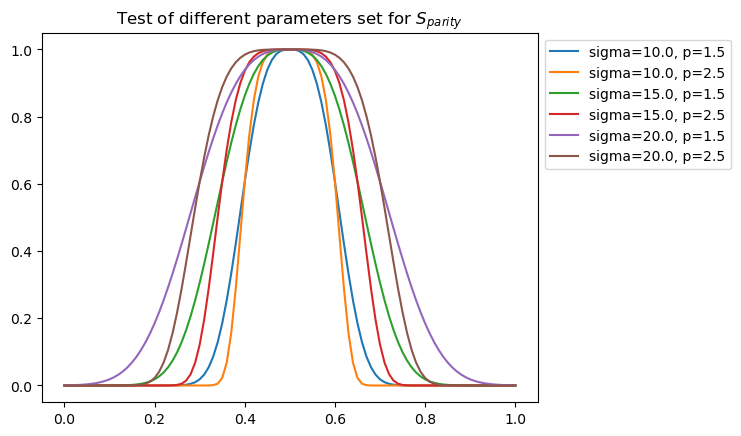

In [58]:
plt.figure()
sigma_list = np.linspace(10.0, 20., 3)  #upper plateau length
p_list      = np.linspace(1.5,  2.5, 2) #slope
for sigma in sigma_list:
    for p in p_list:
        M = 101 #point number
        window = signal.windows.general_gaussian(M, p=p, sig=sigma)
        plt.plot(np.linspace(0,1,M), window, label=f'sigma={round(sigma,2)}, p={round(p, 2)}')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.title('Test of different parameters set for $S_{parity}$')
plt.show()

A convenient choice of parameters  is the following : $\sigma=15, p=1.5$.

Testing this score on some pools of movies to assess its performances, we obtain the following results :

In [60]:
#Test datasets
P0 = pd.DataFrame({"Actor gender":['F','M']}) #Parity. Expect 1
P1 = pd.DataFrame({"Actor gender":['F']}) # Only women. Expect almost 0
P2 = pd.DataFrame({"Actor gender":['M']}) # Only men. Expect almost 0
P3 = pd.DataFrame({"Actor gender":['F','M', 'M']}) # 33% women, expect about 0.5


print(f"The parity score for P0 is : {parity_score(P0)}, "+
      f"and the proportion of women is {P0['Actor gender'].apply(lambda x: x=='F').mean()}\n")
print(f"The parity score for P1 is : {parity_score(P1)}, "+
      f"and the proportion of women is {P1['Actor gender'].apply(lambda x: x=='F').mean()}\n")
print(f"The parity score for P2 is : {parity_score(P2)}, "+
      f"and the proportion of women is {P2['Actor gender'].apply(lambda x: x=='F').mean()}\n")
print(f"The parity score for P3 is : {parity_score(P3)}, "+
      f"and the proportion of women is {P3['Actor gender'].apply(lambda x: x=='F').mean()}\n")

The parity score for P0 is : 1.0, and the proportion of women is 0.5

The parity score for P1 is : 9.067959971965017e-09, and the proportion of women is 1.0

The parity score for P2 is : 9.067959971965017e-09, and the proportion of women is 0.0

The parity score for P3 is : 0.4829453146857076, and the proportion of women is 0.3333333333333333



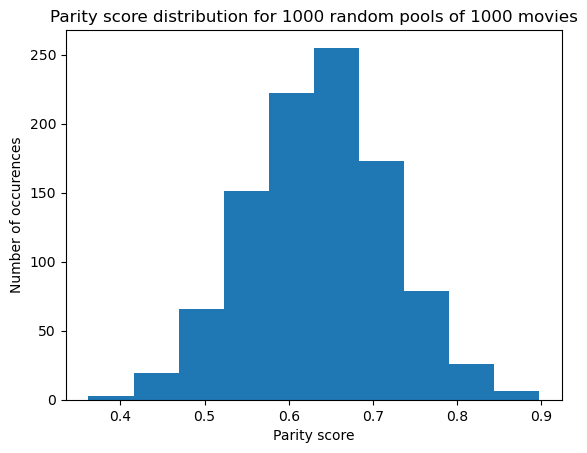

In [62]:
#Test on a large number of random pools of 1000 movies each.
Ntest = 1000
scores_list=[]
for i in range(Ntest):
    P=characterDF.sample(n=1000)
    scores_list.append(parity_score(P))
    
plt.hist(scores_list)
plt.title(f"Parity score distribution for {Ntest} random pools of 1000 movies")
plt.xlabel("Parity score")
plt.ylabel("Number of occurences")
plt.show()

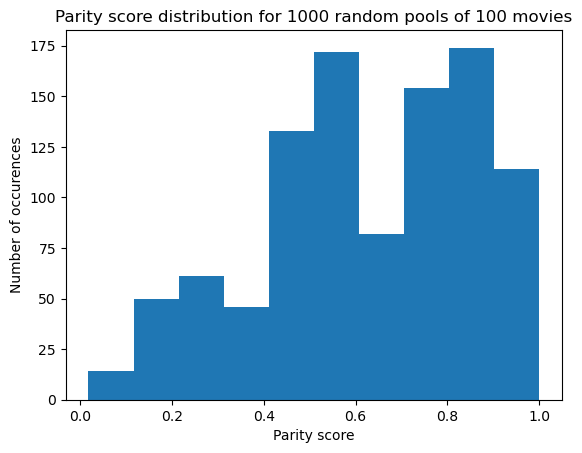

In [63]:
#Test on a large number of random pools of 100 movies each.
scores_list=[]
for i in range(Ntest):
    P=characterDF.sample(n=100)
    scores_list.append(parity_score(P))
    
plt.hist(scores_list)
plt.title(f"Parity score distribution for {Ntest} random pools of 100 movies")
plt.xlabel("Parity score")
plt.ylabel("Number of occurences")
plt.show()


**Partial conclusion:** since a lot of movies have a very poor score, a tradeoff must be found to get a better representation of parity. There is likely a minimum number k for which, on average, pools of k movies have the best scores.
A deeper analysis of this fact will be performed for Milestone 3.

###### Construction of the scoring function $S_{age}$

The goal here is to strongly penalize pools of movies where some ages are overrepresented. The idea is to compare the repartition of ages in $P$ with a reference (in the USA, in 1990).
A first point to mention is that we should differentiate between men and women age distributions, since both are different in real life (women are expected to live longer) and we do not want the bias in parity, already scored, to also influence the age scoring.
We construct age groups with ranges of 5 years, from 0 to 80 years old.

To evaluate the score, we look, for each category of age, at the difference between the reference frequency and the pool frequency, using the same kind of scoring function than for parity. However, we will have to change the $p$ and $\sigma$ parameters since the exploration of the database shows a clear bias for age representation in movies (see histogram below).


In [65]:
plt.hist(characterDF[characterDF['Actor age at movie release']>0]['Actor age at movie release'].dropna(), bins=range(0,80,5))
plt.title("Actor age at movie release histogram")
plt.xlabel("Actor age")
plt.ylabel("Number of occurences")
plt.show()

TypeError: Invalid comparison between dtype=datetime64[ns, UTC] and int